In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Ellipse
import matplotlib
import asciitable
import pyfits
import pylab
import img_scale
import os

# Objectives 

One way to examine the reliability of Bulge+Disk decompositions is to look at their radial profile of the galaxies and the fitted components. Another informative indicator is the residuls of the galaxy, once the model is removed. 

Here are the steps for this analysis:

1. Get the 1D profile of the galaxy, model, bulge, and disk using ELLIPSE. All the parameters will be left free.
2. Evaluate the total uncertainty at each SMA and compare it with residual, besides constructing the 1D profiles.
3. Make a mosaic of the galaxy, model, and residual (if possible)!

# Set Up

In [2]:
galfit = "/Users/Roozbeh/Desktop/Work/Old_Projects/Software/galfit"
PATH = '/Users/Roozbeh/Desktop/Work/Paper3/V2/'
singleComp = pd.read_csv(PATH + 'SM/1comp.csv')
twoComp = pd.read_csv(PATH + 'SM/2comp.csv')
Good2 = twoComp[twoComp.fitGoodness.values == 'high']
Good2.columns

Index([u'Name', u'SN', u'z', u'mass', u'U', u'V', u'J', u'SF1_Quies0', u'SFH',
       u'X_b', u'Y_b', u'Re_b', u'Re_b_kpc', u'Mag_b', u'n_b', u'e_b', u'PA_b',
       u'X_d', u'Y_d', u'h', u'h_kpc', u'Mag_d', u'e_d', u'PA_d', u'BT', u'Re',
       u'Re_kpc', u'Mag', u'n', u'e', u'PA', u'sky_2ser', u'chi2_2ser',
       u'fitGoodness', u'note'],
      dtype='object')

# Helper Functions

## Constructing Image of Each Object: galaxy/model/bulge/disk 

In [3]:
def construct_subComponent(imageName, Type, Directory='2comp'):
    """
    Create a FITS file which contains only Bulge or Disk component
    """
    
    # Finding the size of the image
    image_size = len(pyfits.open(PATH + 'Fits/' + Directory + '/' + imageName[:-3] + '2ser.fit')[2].data)    
    twoCompModel = pyfits.open(PATH + 'Fits/' + Directory + '/' + imageName[:-3] + '2ser.fit')
    
    # Creating the subcompents image
    os.system(galfit + ' -o3 ' + PATH + 'Read/' +  Directory + '/' + imageName[:-3] + '2ser.read')
    subComp = pyfits.open('subcomps.fits')
    
    ZeroArray = np.zeros([image_size,image_size])
    canvas = pyfits.PrimaryHDU(ZeroArray)
    canvas_comp = canvas.data

    if Type == 'galaxy':
        canvas_comp += subComp[0].data - subComp[3].data
    elif Type == 'model':
        canvas_comp += twoCompModel[2].data - subComp[3].data
    elif Type == 'bulge':
        canvas_comp += subComp[1].data
    elif Type == 'disk':
        canvas_comp += subComp[2].data
    else:
        raise 'unknow type!'
        
    canvas.data = canvas_comp
    canvas.writeto(PATH  + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_' + Type + '.fit')

## Constructing Surface Brightness Profile Using ELLIPSE  

In [4]:
def findInitial_e_PA(imageName, Type):
    """
    finds the measured ellipticity and position angle for the galaxy.
    It is using the fact that the galaxy in at the center of the imgae
    """
    
    # For the model or galaxy: use the single component model result
    if Type.lower() == 'model' or Type.lower() == 'galaxy':
        e0 = make_float(singleComp[singleComp.Name == imageName]['e'])
        PA0 = make_float(singleComp[singleComp.Name == imageName]['PA'])
        
    # For the DISK component: use the Disk component ellipticity & PA result
    elif Type.lower() == 'disk':
        e0 = make_float(twoComp[twoComp.Name == imageName]['e_d'])
        PA0 = make_float(twoComp[twoComp.Name == imageName]['PA_d'])
        
    # For the BULGE component: use the Disk component PA result & set the ellipticity to 0.2
    elif Type.lower() == 'bulge':
        e0 = 0.2
        PA0 = make_float(twoComp[twoComp.Name == imageName]['PA_d'])
    
    return (e0, PA0)

In [5]:
def ellipse(imageName, e0, PA0, Type, Directory='2comp',\
            hold_e='yes', hold_PA='yes', magzpt=26, step_size=0.04):
    """
    Baically does what ELLIPSE/IRAF does but have limited options for editing
    """
     
    # Creating the parameter file for ELLIPSE
    fp = open(PATH + '/Par/ellipse.par','r')
    ellipse_par = fp.readlines()
    fp.close()  

    if Type.lower() == 'galaxy': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_galaxy.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_galaxy.fit' + '\n'
    elif Type.lower() == 'model': 
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_model.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp//' + imageName[:-3] + '2ser_model.fit' + '\n'
    elif Type.lower() == 'bulge':
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_bulge.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_bulge.fit' + '\n'
    elif Type.lower() == 'disk':
        image_size = len(pyfits.open(PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_disk.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_disk.fit' + '\n'
    elif Type.lower() == 'unconv':
        image_size = len(pyfits.open(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_unconv.fit')[0].data)    
        ellipse_par[0] = 'ellipse.input = ' + PATH  + 'Fits/2comp/' + imageName[:-3] + '2ser_unconv.fit' + '\n'
        
    ellipse_par[1] = 'ellipse.output = ' + PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.bin' + '\n'
    ellipse_par[2] = 'geompar.x0= ' + str(image_size/2) + '\n'
    ellipse_par[3] = 'geompar.y0= ' + str(image_size/2) + '\n'
    ellipse_par[4] = 'geompar.ellip0 = ' + str(e0) + '\n'
    ellipse_par[5] = 'geompar.pa0 = ' + str(PA0) + '\n'
    ellipse_par[6] = 'magpar.mag0 = ' + str(magzpt) + '\n'
    ellipse_par[7] = 'geompar.maxsma = ' + str(image_size/2) + '\n'
    ellipse_par[8] = 'controlpar.hellip = ' + str(hold_e) + '        \n'
    ellipse_par[9] = 'controlpar.hpa = ' + str(hold_PA) + '           \n'
    ellipse_par[10] = 'geompar.step = ' + str(step_size) + '          \n' 
   
    output = open(PATH + '/Par/ellipse' + imageName + '.par','w')
    output.writelines(ellipse_par)
    output.close()  
    
    # Running ELLIPSE
    os.system('/usr/stsci/stsci_iraf-3.14/stsdas/bin.macintel/x_isophote.e \
               ellipse @' + PATH + '/Par/ellipse' + imageName + '.par')

    # Removing the parameter file
    os.system('rm ' + PATH + '/Par/ellipse' + imageName + '.par')

In [6]:
def tdump(imageName, Type):
    """
    Baically does what Tdump/IRAF does
    """  
    
    # Creating the parameter file for Tdump
    ff = open(PATH + '/Par/tdump.par','r')
    tdump_param = ff.readlines()
    ff.close()
    
    tdump_param[0] = 'tdump.table = ' +  PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.bin' + '\n'
    tdump_param[3] = 'tdump.datafile = ' +  PATH + '1D/' + imageName[:-3] + '2ser' + '_' + Type + '.dat' + '\n'
    
    output = open(PATH + '/Par/tdump' + imageName + '.par','w')
    output.writelines(tdump_param)
    output.close()
    
    # Running Tdump and removing the parameter file
    os.system('/usr/stsci/stsci_iraf-3.14/tables/bin.macintel/x_ttools.e \
                tdump @' + PATH + '/Par/tdump' + imageName + '.par')  
    os.system('rm ' + PATH + '/Par/tdump' + imageName + '.par')             

## Measuring The Total Size Using Bulge+Disk Model 

In [13]:
def size_using_2comp(imageName, Directory='2comp'):
    """
    Measured Curve of Growth using Ellipse/IRAF
    """
    
    ### Construct the unconvoled 2comp model galaxy
    hu = open(PATH + 'Read/' + Directory +'/' + imageName[:-3] + '2ser.read','r')
    lines = hu.readlines()
    hu.close()

    # No input image
    lines[7] = 'A) None \n'
    # Rename the output image
    lines[8] = 'B) ' + PATH + 'Fits/' + Directory +'/' + imageName[:-3] + '2ser_unconv.fit' + ' \n'
    # No sigma image --> Just in case
    lines[9] = 'C) None \n'
    # No PSF
    lines[10] = 'D) None \n'

    output = open('test.read','w')
    output.writelines(lines[1:64])
    output.close()
    
    os.system(galfit + ' test.read')
    
    ### Getting CofG for the unconv 2comp model
    e0, pa0 = findInitial_e_PA(imageName, Type='galaxy')
    ellipse(imageName,e0=e0,PA0=pa0,Type='unconv')
    tdump(imageName,Type='unconv')
    
    CofG_dat = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_unconv.dat')
    mag_1d = CofG_dat[len(CofG_dat)-1][22]
    flux_t = CofG_dat[len(CofG_dat)-1][20]

    ## calculating the half light radius based on total flux
    for i in range(len(CofG_dat)):
        if CofG_dat[i][20] > flux_t/2:
            Re_1d = (CofG_dat[i][0] + CofG_dat[i-1][0])/2
            break
    
    return Re_1d

In [14]:
name = 'z0.6_m11.1_8151_uds_drz'
size_using_2comp(name)

9.4173720000000003

## Measuring Background Noise 

In [9]:
def measure_background_sigma(imageName):
    """
    Purpose: finding backgroun sigma
    by making a list of all background pixels and find its standard deviation
    """
    
    image_size = len(pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')[0].data)
    mm_image =  pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName[:-4] + '_mm.fits')   
    mm_pixels = mm_image[0].data
    
    pixelValues = []
    sky = pyfits.open(PATH + 'Fits/Sample/FINE/' + imageName + '.fit')
    bkg_pixel = sky[0].data

    for axis1 in range(len(mm_pixels)):
        for axis2 in range(len(mm_pixels[0])):
            if mm_pixels[axis1,axis2] == 0:
                # and not near the center (i.e., galaxy)
                if axis1 not in range(int(image_size/2)-50, int(image_size/2)+50) and\
                   axis2 not in range(int(image_size/2)-50, int(image_size/2)+50):
                        pixelValues.append(bkg_pixel[axis1,axis2])

    STD = np.std(pixelValues)    
    return STD

## Plotting The Surface Brightness For Checking The Goodness of The Fit 

In [10]:
def plot_surface_brightness(imageName):
    """
    Constructing the good-old surface brightness profile!
    """
    
    plt.style.use('ggplot')
    
    galaxy = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_galaxy.dat')
    model = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_model.dat')
    bulge = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_bulge.dat')
    disk = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_disk.dat')

    SMA_galaxy = galaxy['col1']*0.06
    mu_galaxy = -2.5*np.log10(galaxy['col2']/(0.06*0.06)) + 26
    mu_model = -2.5*np.log10(model['col2']/(0.06*0.06)) + 26
    mu_bulge = -2.5*np.log10(bulge['col2']/(0.06*0.06)) + 26
    mu_disk = -2.5*np.log10(disk['col2']/(0.06*0.06)) + 26

    bkg_err = measure_background_sigma(imageName)
    sigma = np.sqrt( np.square(galaxy['col3']) + bkg_err**2 )
    errBar = 2.50 * np.log( 1.0 + ( sigma / abs(galaxy['col2'])))
    
    plt.figure(figsize=(10,8))
    plt.scatter(SMA_galaxy,mu_galaxy, color='red', marker='o', label='Data')
    plt.errorbar(SMA_galaxy,mu_galaxy, yerr=errBar, color='red', marker='.', 
                 elinewidth = .2,linestyle='None', markerfacecolor='none')
    plt.scatter(SMA_galaxy,mu_model, color='blue', marker='.', label='Bulge+Disk')
    plt.scatter(SMA_galaxy,mu_bulge, color='green',marker='.', label='Bulge')
    plt.scatter(SMA_galaxy,mu_disk, color='cyan',marker='.', label='Disk')

    plt.legend(loc='upper right', numpoints=1, ncol=1, fontsize=18)

    plt.xscale('log')
    plt.xlim([min(SMA_galaxy),max(SMA_galaxy)])
    plt.ylim([26,min(mu_galaxy)-.3])
    
    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 13}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=14)
    plt.tick_params(axis='y', labelsize=14)
    plt.xlabel('log(Semi Major Axis) (arcsec)')
    plt.ylabel('<$\mu$> ($mag/acrsec^{2}$)')
    
    plt.savefig(PATH + '1D/' + imageName[:-3] + '2ser_1D.jpg')

In [11]:
def plot_residuals(imageName):
    """
    Constructing the good-old surface brightness profile!
    """
    
    plt.style.use('ggplot')
    
    galaxy = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_galaxy.dat')
    model = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_model.dat')

    # Calculate the residuals
    SMA_galaxy = galaxy['col1']*0.06
    mu_galaxy = -2.5*np.log10(galaxy['col2']/(0.06*0.06)) + 26
    mu_model = -2.5*np.log10(model['col2']/(0.06*0.06)) + 26
    mu_diff = mu_model - mu_galaxy
    
    # Calculating the total error
    bkg_err = measure_background_sigma(imageName)
    galaxy_err = np.sqrt( np.square(galaxy['col3']) + bkg_err**2 )
    model_err = model['col3']
    total_err = np.sqrt((galaxy_err/abs(galaxy['col2']))**2 + (model_err/abs(model['col2']))**2)
    errBar = 2.50 * np.log( 1.0 + total_err)
    
    plt.figure(figsize=(10,3))
    plt.scatter(SMA_galaxy,mu_diff, color='red', marker='o', label='Data')
    plt.errorbar(SMA_galaxy,mu_diff, yerr=errBar, color='blue', marker='.', 
                 elinewidth = .2,linestyle='None', markerfacecolor='none')

    #plt.legend(loc='upper right', numpoints=1, ncol=1, fontsize=18)

    plt.xscale('log')
    plt.xlim([min(SMA_galaxy),max(SMA_galaxy)])
    plt.ylim([-1,1])
    
    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 13}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=14)
    plt.tick_params(axis='y', labelsize=14)
    plt.xlabel('log(Semi Major Axis) (arcsec)')
    plt.ylabel('$\Delta <\mu$> ($mag/acrsec^{2}$)')
    
    #plt.savefig(PATH + '1D/' + imageName[:-3] + '2ser_1D.jpg')

In [18]:
def plot_diagnostic(imageName):
    """
    Constructing the good-old surface brightness profile!
    """

    #################################################
    ###### Finding the galaxy catalogue entry #######
    #################################################

    cat = twoComp[twoComp.Name == imageName]
    
    ##################################
    ###### Basic Figure Set up #######
    ##################################
    
    plt.style.use('ggplot')
    fig = plt.figure(figsize=(10, 8),frameon=False) 
    gs = gridspec.GridSpec(3,3)    ## Creating space for subplots
    font = {'weight' : 'bold', 'size': 15}
    matplotlib.rc('font', **font)
    # Adjusting the size of xlabel and ylabel
    plt.rcParams['font.size'] = 15.0
    
    #####################################################
    ###### Reading the data and calculating error #######
    #####################################################

    ### Reading All The Files
    galaxy = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_galaxy.dat')
    model = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_model.dat')
    bulge = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_bulge.dat')
    disk = asciitable.read(PATH + '1D/' + imageName[:-3] + '2ser_disk.dat')
    
    galaxy_img = pyfits.getdata(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_galaxy.fit')
    model_img = pyfits.getdata(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_model.fit')
    resid_img = pyfits.open(PATH + '/Fits/2comp/' + imageName[:-3] + '2ser.fit')[3].data
    image_size = len(galaxy_img)    
    
    ### Converting Flux to Surface Brightness
    SMA_galaxy = galaxy['col1']*0.06
    mu_galaxy = -2.5*np.log10(galaxy['col2']/(0.06*0.06)) + 26
    mu_model = -2.5*np.log10(model['col2']/(0.06*0.06)) + 26
    mu_bulge = -2.5*np.log10(bulge['col2']/(0.06*0.06)) + 26
    mu_disk = -2.5*np.log10(disk['col2']/(0.06*0.06)) + 26
    mu_diff = mu_model - mu_galaxy
        
    ### Calculating the total error
    bkg_err = measure_background_sigma(imageName)
    galaxy_err = np.sqrt(np.square(galaxy['col3']) + bkg_err**2)
    model_err = model['col3']
    total_err = np.sqrt((galaxy_err/abs(galaxy['col2']))**2 + (model_err/abs(model['col2']))**2)
    errBar = 2.50 * np.log( 1.0 + total_err)
    
    ##############################################
    ######## Plot1 -- Surface Brightness #########
    ##############################################

    ax1 = plt.subplot(gs[0:2,0:2])
    ax1.set_xscale('log') 
    
    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 15}
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=12)
    plt.tick_params(axis='y', labelsize=13)
    
    ax1.scatter(SMA_galaxy,mu_galaxy, color='black', marker='o', label='Data')
    ax1.errorbar(SMA_galaxy,mu_galaxy, yerr=galaxy_err/abs(galaxy['col2']), color='cyan', marker='.', 
                 elinewidth = .3,linestyle='None', markerfacecolor='none')
    ax1.scatter(SMA_galaxy,mu_model, color='cyan', marker='.', label='Bulge+Disk')
    ax1.scatter(SMA_galaxy,mu_bulge, color='red',marker='o', label='Bulge',s=5) ## s stand for area --> size
    ax1.scatter(SMA_galaxy,mu_disk, color='blue',marker='o', label='Disk',s=6)
    ax1.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax1.set_ylim([26,min(mu_galaxy)-.3])
    
    
    ##############################################
    ######### Adding Text (Galaxy Info) ##########
    ##############################################
    
    font = {'weight' : 'bold', 'size': 15}
    ax1.annotate('z=' + str(round(float(cat['z']),2)), xy=(0.06, 23), xytext=(.06, 23))
    ax1.annotate('mass=' + str(round(float(cat['mass']),2)), xy=(0.06, 24), xytext=(.06, 24))
    ax1.annotate('B/T=' + str(round(float(cat['BT']),2)), xy=(0.06, 25), xytext=(.06, 25))

    ax1.legend(loc='upper right', numpoints=1, ncol=1, fontsize=15)
    ax1.set_ylabel('<$\mu$> ($mag/acrsec^{2}$)')

    #####################################
    ######## Plot2 -- Residuals #########
    #####################################
    
    ax2 = plt.subplot(gs[2,0:2], sharex=ax1)
    plt.setp(ax1.get_xticklabels(), visible=False)
    ax2.set_xscale('log') 

    # Adjusting the size of legends
    font = {'weight' : 'bold', 'size': 15}
    # Adjusting the size of numbers on the axies
    plt.tick_params(axis='x', labelsize=13)
    plt.tick_params(axis='y', labelsize=12)
    
    ax2.scatter(SMA_galaxy,mu_diff, color='magenta', marker='o', label='Data')
    ax2.errorbar(SMA_galaxy,mu_diff, yerr=errBar, color='black', marker='.', 
                 elinewidth = .1,linestyle='None', markerfacecolor='none')

    ax2.set_xlim([min(SMA_galaxy),max(SMA_galaxy)])
    ax2.set_ylim([-1,1])
    
    ax2.set_xlabel('log(Semi Major Axis) ($arcsec$)')
    ax2.set_ylabel('$\Delta <\mu$> ($mag/acrsec^{2}$)')    
    
    
    ##################################
    ######### FITS Files #############
    ##################################
    
    matplotlib.rcParams.update(matplotlib.rcParamsDefault)
    #plt.figure(frameon=False)
    ax3 = plt.subplot(gs[0,-1])
    ax3.set_frame_on(False)
    
    ax3.imshow(np.log(galaxy_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax3.axis('off')

    
    ax4 = plt.subplot(gs[1,-1])
    ax4.set_frame_on(False)

    ell_bulge = Ellipse(xy=(50,50), width=float(cat['Re_b']), height=float(cat['Re_b']*cat['e_b']), 
                        angle=float(cat['PA_b'])+90, fill=False, snap=False,color = 'red',lw=1)
    ell_disk = Ellipse(xy=(50,50), width=float(cat['h']), height=float(cat['h']*cat['e_d']), 
                       angle=float(cat['PA_d'])+90, fill=False, snap=False,color = 'blue',lw=1)
    ax4.add_patch(ell_bulge)
    ax4.add_patch(ell_disk)
    ax4.imshow(np.log10(model_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50]), cmap='gray', 
               interpolation='nearest', origin='lower')
    ax4.axis('off')

    
    ax5 = plt.subplot(gs[2,-1])
    ax5.set_frame_on(False)
    ax5.imshow(resid_img[image_size/2-50:image_size/2+50,image_size/2-50:image_size/2+50], cmap='gray', 
               interpolation='nearest', origin='lower')
    ax5.add_patch(ell_bulge)
    ax5.add_patch(ell_disk)
    ax5.axis('off')
    
    plt.tight_layout()
    
    plt.savefig(PATH + '1D/' + imageName[:-3] + '2ser_1D.jpg')        

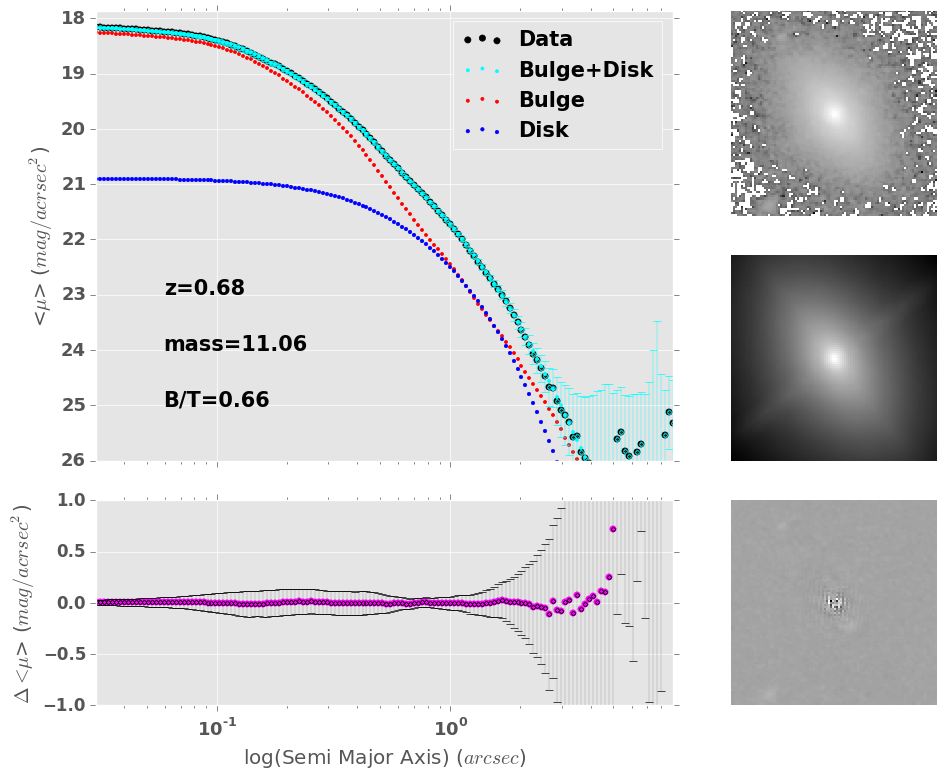

In [19]:
plot_diagnostic('z0.7_m11.1_16563.0_cosmos_drz')

## Misc. 

In [11]:
def round3(x): return round(x,3)

def make_float(parameter):
    try:
        return float(parameter[0])
    except:
        return float(parameter)

# Constructing The Radial Profiles 

## Galaxy

In [169]:
# For each row in Good fits
for Index in Good2.index:
    
    # find the imageName
    imageName = Good2.ix[Index].Name
    
    if imageName[:-3] + '2ser_galaxy.fit' not in os.listdir(PATH + 'Fits/2comp/'):
        construct_subComponent(imageName, Type='galaxy')
    
    # Get initial values for ellipticity and PA
    e0, PA0 = findInitial_e_PA(imageName,'galaxy')
    
    # Run ELLIPSE & convert it to the asciitables
    ellipse(imageName,e0=e0,PA0=PA0,Type='galaxy')
    tdump(imageName,Type='galaxy')

## Model

In [170]:
# For each row in Good fits
for Index in Good2.index:
    
    # find the imageName
    imageName = Good2.ix[Index].Name
    
    if imageName[:-3] + '2ser_model.fit' not in os.listdir(PATH + 'Fits/2comp/'):
        construct_subComponent(imageName, Type='model')
    
    # Get initial values for ellipticity and PA
    e0, PA0 = findInitial_e_PA(imageName,'galaxy')
    
    # Run ELLIPSE & convert it to the asciitables
    ellipse(imageName,e0=e0,PA0=PA0,Type='model')
    tdump(imageName,Type='model')

## Bulge 

In [171]:
# For each row in Good fits
for Index in Good2.index:
    
    # find the imageName
    imageName = Good2.ix[Index].Name

    if imageName[:-3] + '2ser_bulge.fit' not in os.listdir(PATH + 'Fits/2comp/'):
        construct_subComponent(imageName, Type='bulge')
    
    # Get initial values for ellipticity and PA
    e0, PA0 = findInitial_e_PA(imageName,'galaxy')
    
    # Run ELLIPSE & convert it to the asciitables
    ellipse(imageName,e0=e0,PA0=PA0,Type='bulge')
    tdump(imageName,Type='bulge')

## Disk

In [172]:
# For each row in Good fits
for Index in Good2.index:
    
    # find the imageName
    imageName = Good2.ix[Index].Name

    if imageName[:-3] + '2ser_disk.fit' not in os.listdir(PATH + 'Fits/2comp/'):
        construct_subComponent(imageName, Type='disk')
    
    # Get initial values for ellipticity and PA
    e0, PA0 = findInitial_e_PA(imageName,'galaxy')
    
    # Run ELLIPSE & convert it to the asciitables
    ellipse(imageName,e0=e0,PA0=PA0,Type='disk')
    tdump(imageName,Type='disk')

# Visualization 

## Surface Brightness Diagnostic Plots 

Let's create a diagnostic plot for each galaxy.

/Users/Roozbeh/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:424: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


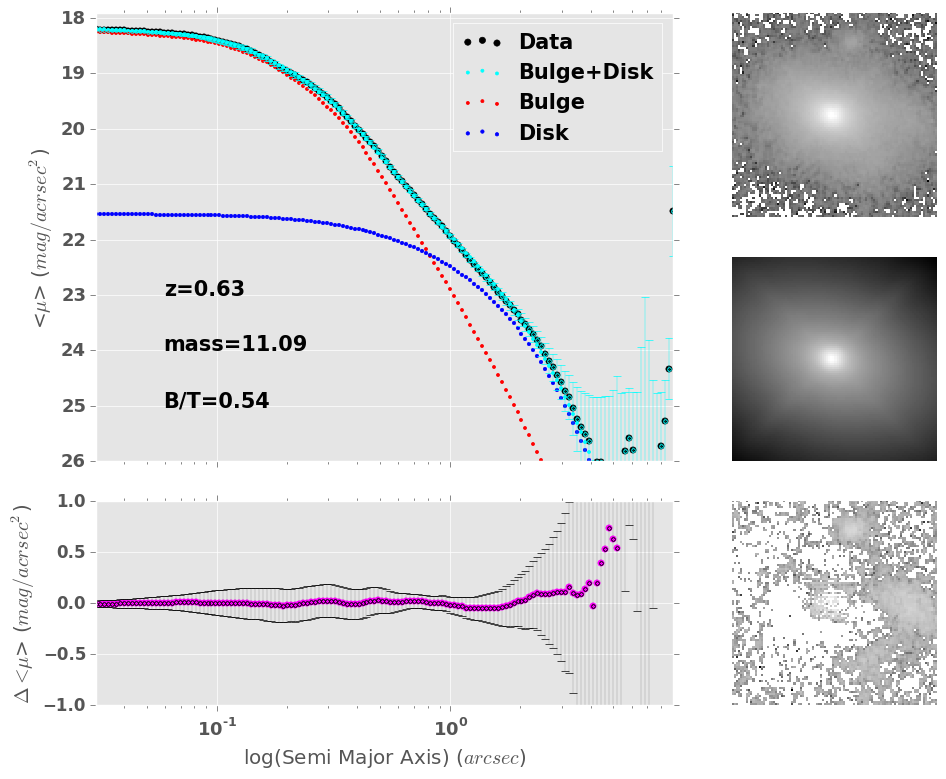

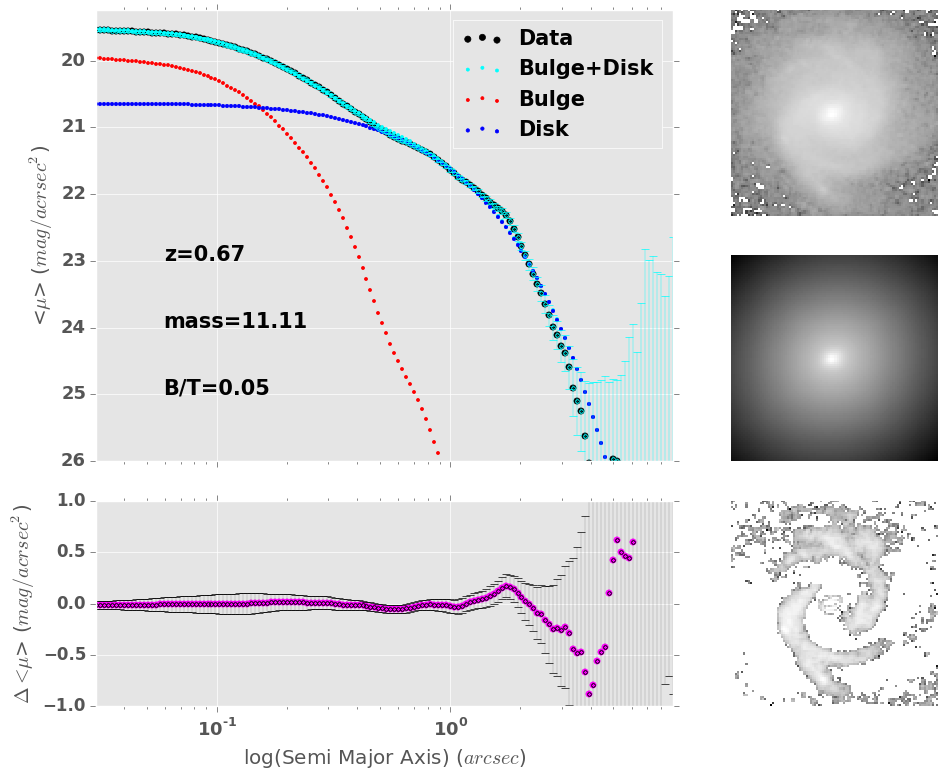

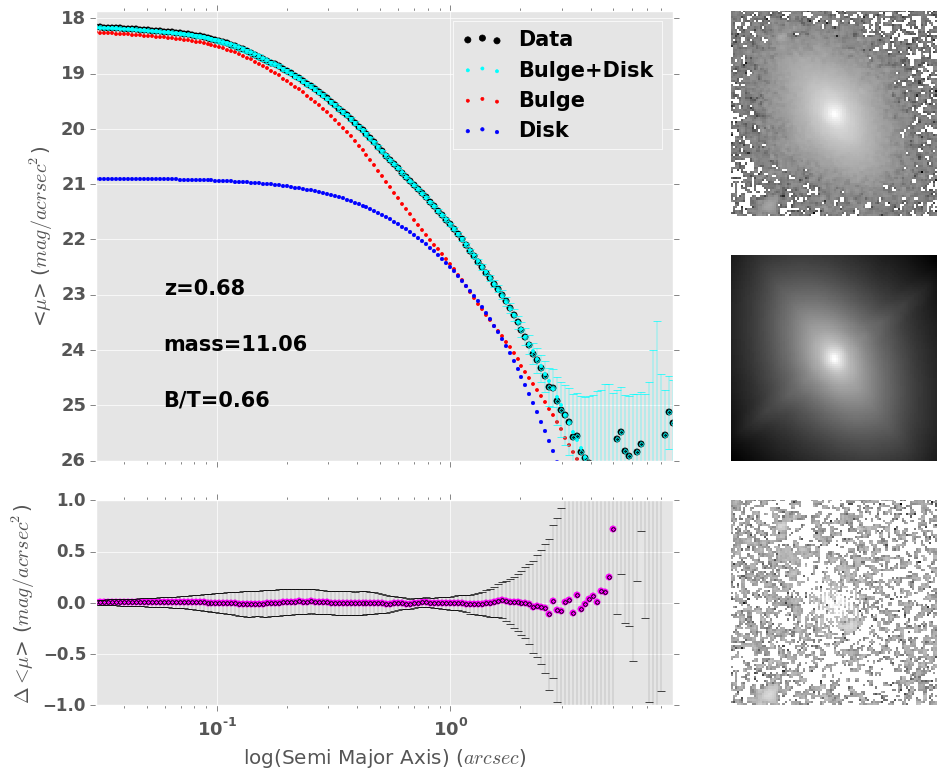

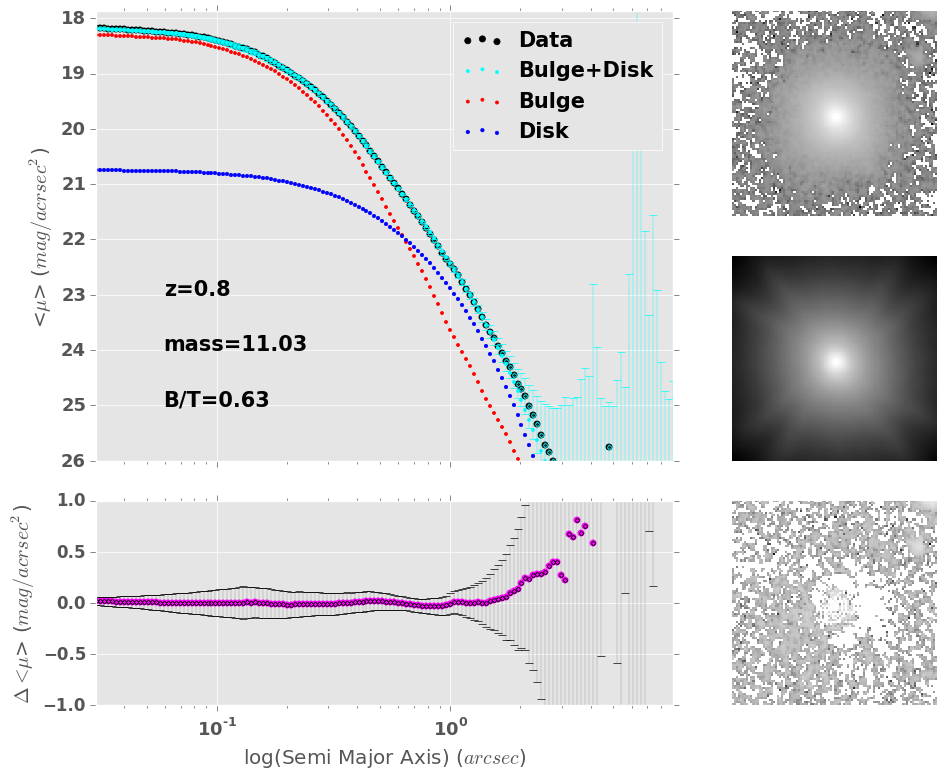

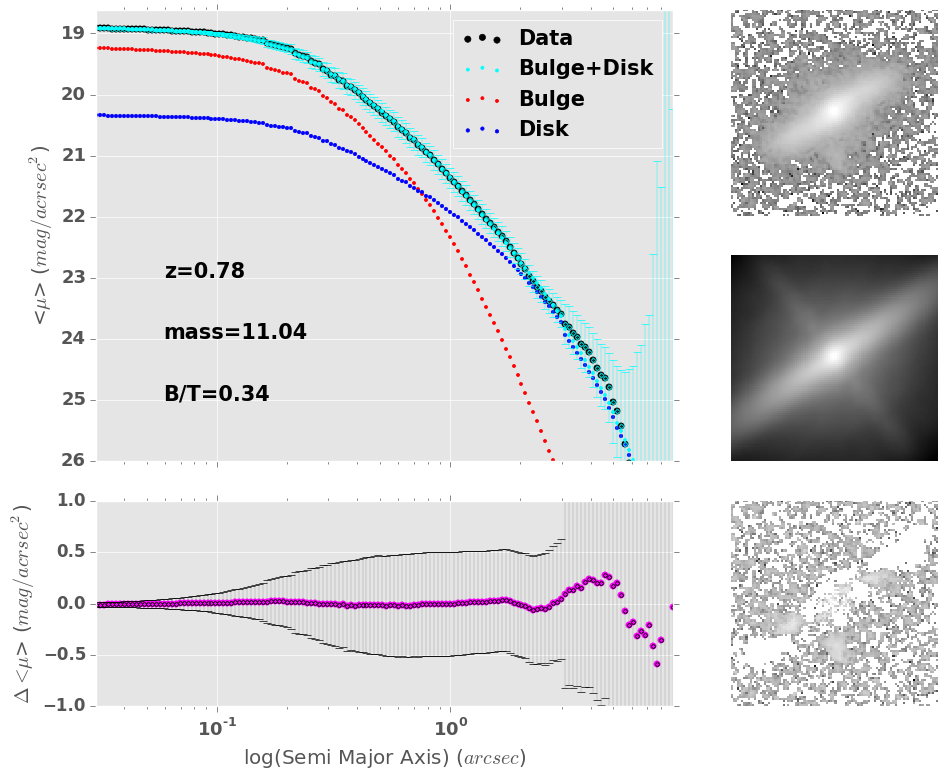

...

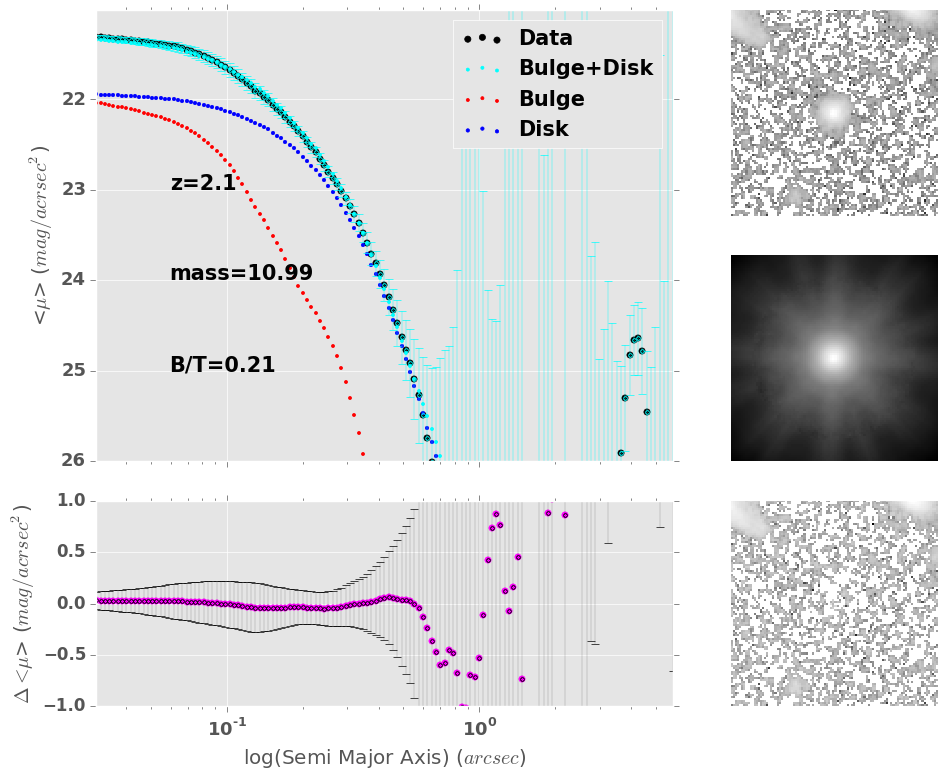

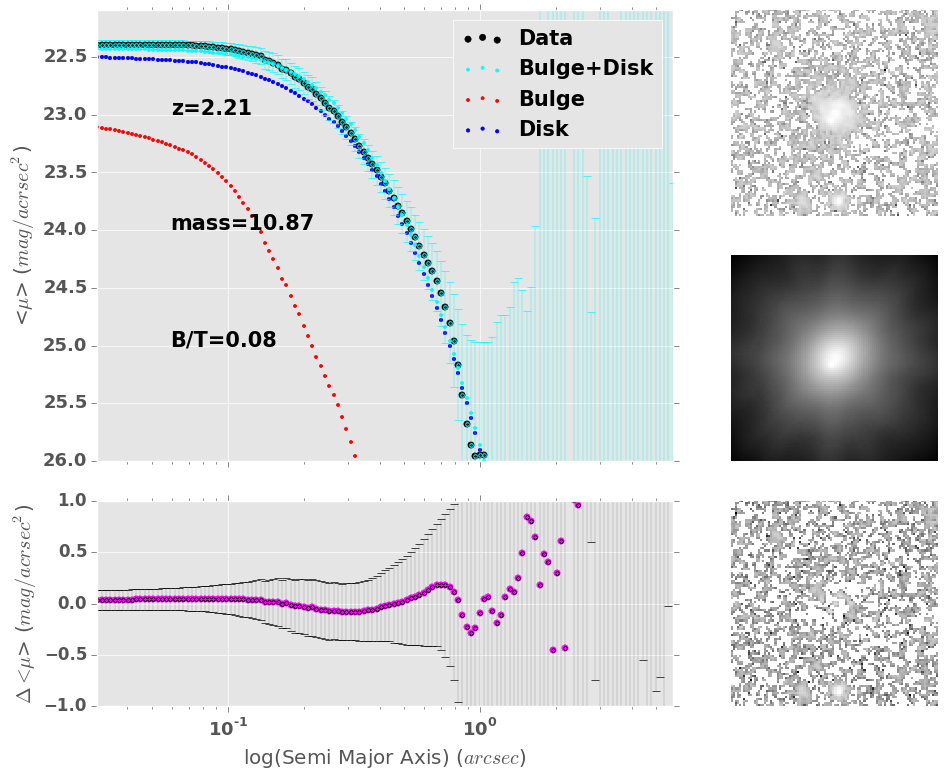

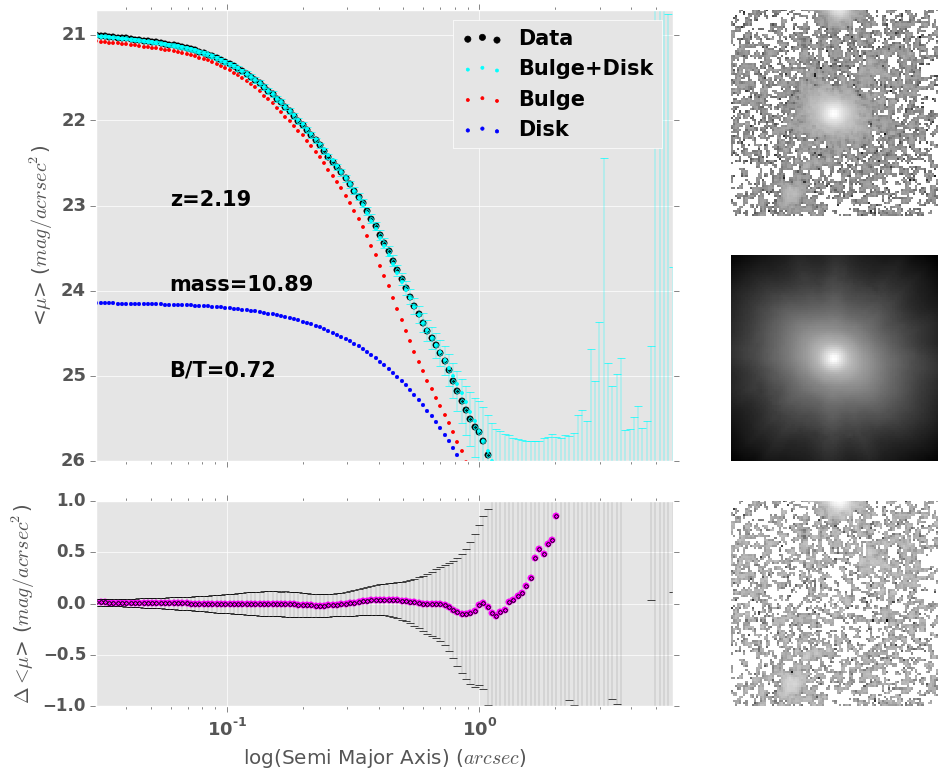

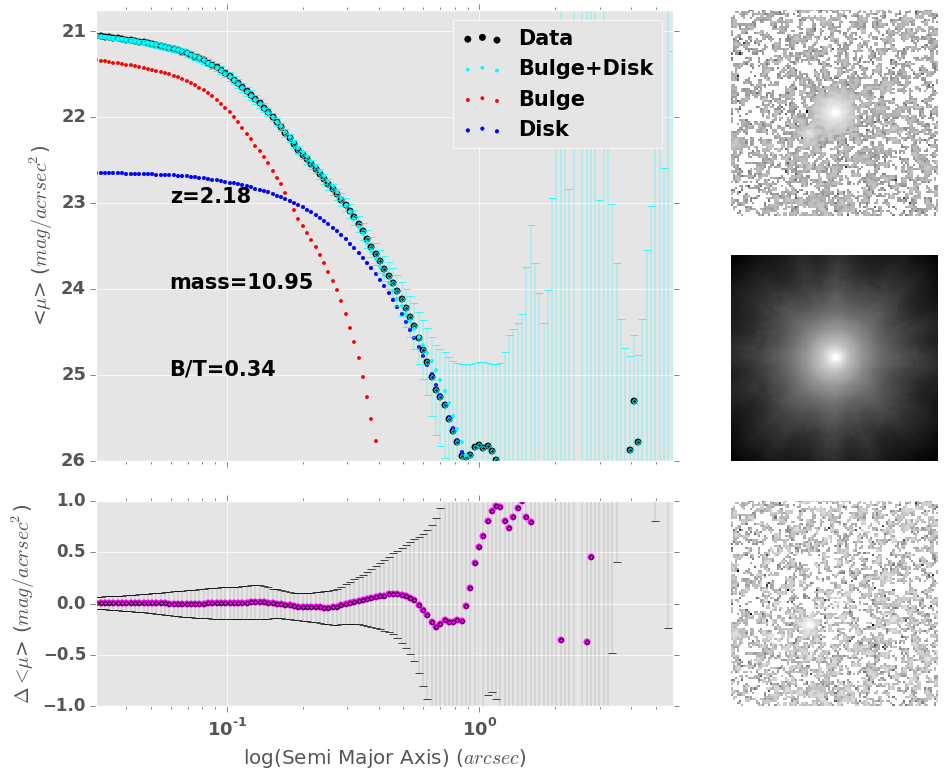

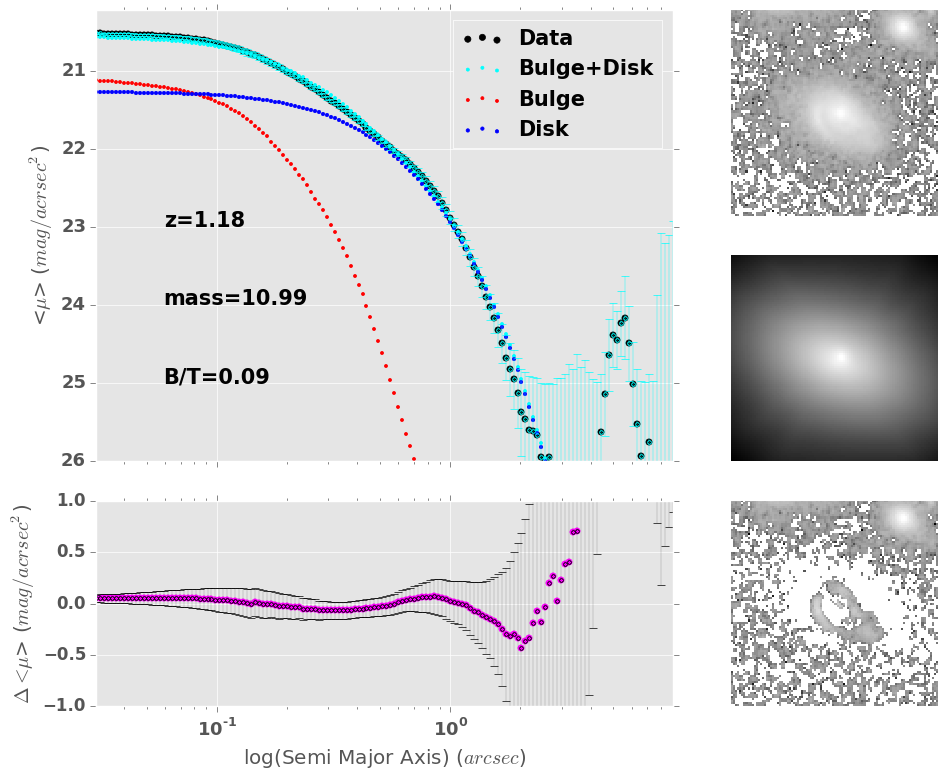

In [212]:
for Index in Good2.index:
    
    # find the imageName
    imageName = Good2.ix[Index].Name
    
    plot_diagnostic(imageName)

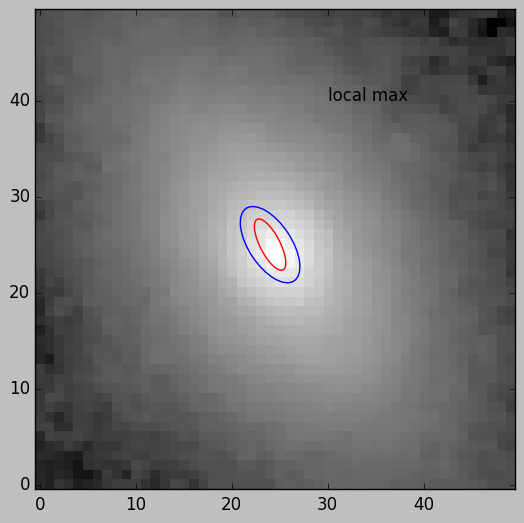

In [186]:
from matplotlib.patches import Ellipse

gs = gridspec.GridSpec(3,3)


cat = twoComp[twoComp.Name == 'z0.7_m11.1_16563.0_cosmos_drz']
fig,ax = plt.subplots()

imageName = 'z0.7_m11.1_16563.0_cosmos_drz'
galaxy_img = pyfits.getdata(PATH + 'Fits/2comp/' + imageName[:-3] + '2ser_galaxy.fit')
image_size = len(galaxy_img)

ell_bulge = Ellipse(xy=(24,25), width=float(cat['Re_b']), height=float(cat['Re_b']*cat['e_b']), 
                    angle=float(cat['PA_b'])+90, fill=False, snap=False,color = 'red',lw=1)
ell_disk = Ellipse(xy=(24,25), width=float(cat['h']), height=float(cat['h']*cat['e_d']), 
                   angle=float(cat['PA_d'])+90, fill=False, snap=False,color = 'blue',lw=1)
ax.add_patch(ell_bulge)
ax.add_patch(ell_disk)

ax.annotate('local max', xy=(30, 30), xytext=(30, 40))
ax.imshow(np.log(galaxy_img[image_size/2-25:image_size/2+25,image_size/2-25:image_size/2+25]), cmap='gray', 
               interpolation='nearest', origin='lower')
#ax.axis('off')


In [156]:
gs[0:0]